## IOWA UNIVERSITY https://mesonet.agron.iastate.edu/request/download.phtml?network=ES__ASOS

In [19]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [1]:
#@title Get metar
station = "LEBL" #@param {type:"string"}
from_year = "2018" #@param {type:"string"}
from_month = "01" #@param {type:"string"}
from_day = "01" #@param {type:"string"}
to_year = "2022" #@param {type:"string"}
to_month = "12" #@param {type:"string"}
to_day = "31" #@param {type:"string"}

import pandas as pd
import numpy as np

s1="https://mesonet.agron.iastate.edu/cgi-bin/request/asos.py?station="
OACI=station
#s2="&data=drct&data=sknt"
s2="&data=all"
s3="&year1="+from_year+"&month1="+from_month+"&day1="+from_day
s4="&year2="+to_year+"&month2="+to_month+"&day2="+to_day
s5="&tz=Etc%2FUTC&format=onlycomma&latlon=no&missing=M&trace=T&direct=no&report_type=1&report_type=2"
url=s1+OACI+s2+s3+s4+s5
df=pd.read_csv(url,parse_dates=["valid"],).rename({"valid":"time"},axis=1)
df

<ipython-input-1-bd4ffbe29e92>:21: DtypeWarning: Columns (2,3,4,6,8,10,27) have mixed types. Specify dtype option on import or set low_memory=False.
  df=pd.read_csv(url,parse_dates=["valid"],).rename({"valid":"time"},axis=1)


,station,time,tmpf,dwpf,relh,drct,sknt,p01i,alti,mslp,...,wxcodes,ice_accretion_1hr,ice_accretion_3hr,ice_accretion_6hr,peak_wind_gust,peak_wind_drct,peak_wind_time,feel,metar,snowdepth
0,LEBL,2018-01-01 00:00:00,57.20,39.20,50.91,280.00,14.00,0.0,30.06,M,...,M,M,M,M,M,M,M,57.20,LEBL 010000Z 28014KT 9999 FEW020 14/04 Q1018 N...,M
1,LEBL,2018-01-01 00:30:00,57.20,35.60,44.19,280.00,12.00,0.0,30.06,M,...,M,M,M,M,M,M,M,57.20,LEBL 010030Z 28012KT 9999 FEW020 14/02 Q1018 N...,M
2,LEBL,2018-01-01 01:00:00,55.40,32.00,40.84,310.00,13.00,0.0,30.09,M,...,M,M,M,M,M,M,M,55.40,LEBL 010100Z 31013KT 9999 FEW020 13/00 Q1019 N...,M
3,LEBL,2018-01-01 01:30:00,53.60,33.80,46.88,320.00,13.00,0.0,30.09,M,...,M,M,M,M,M,M,M,53.60,LEBL 010130Z 32013G25KT 290V350 9999 FEW020 12...,M
4,LEBL,2018-01-01 02:00:00,51.80,33.80,50.08,320.00,13.00,0.0,30.12,M,...,M,M,M,M,M,M,M,51.80,LEBL 010200Z 32013KT 9999 FEW020 11/01 Q1020 N...,M
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
87995,LEBL,2022-12-30 21:30:00,57.20,48.20,71.83,290.00,8.0,0.0,30.21,M,...,M,M,M,M,M,M,M,57.20,LEBL 302130Z 29008KT CAVOK 14/09 Q1023 NOSIG,M
87996,LEBL,2022-12-30 22:00:00,55.40,48.20,76.66,270.00,6.0,0.0,30.21,M,...,M,M,M,M,M,M,M,55.40,LEBL 302200Z 27006KT 9999 FEW050 13/09 Q1023 N...,M
87997,LEBL,2022-12-30 22:30:00,53.60,48.20,81.87,280.00,6.0,0.0,30.24,M,...,M,M,M,M,M,M,M,53.60,LEBL 302230Z 28006KT CAVOK 12/09 Q1024 NOSIG,M
87998,LEBL,2022-12-30 23:00:00,53.60,48.20,81.87,290.00,9.0,0.0,30.24,M,...,M,M,M,M,M,M,M,53.60,LEBL 302300Z 29009KT CAVOK 12/09 Q1024 NOSIG,M


In [ ]:
!pip install klib
import klib

In [2]:
df.columns

Index(['station', 'time', 'tmpf', 'dwpf', 'relh', 'drct', 'sknt', 'p01i',
       'alti', 'mslp', 'vsby', 'gust', 'skyc1', 'skyc2', 'skyc3', 'skyc4',
       'skyl1', 'skyl2', 'skyl3', 'skyl4', 'wxcodes', 'ice_accretion_1hr',
       'ice_accretion_3hr', 'ice_accretion_6hr', 'peak_wind_gust',
       'peak_wind_drct', 'peak_wind_time', 'feel', 'metar', 'snowdepth'],
      dtype='object')

In [ ]:
#today metar
from datetime import timedelta
today=pd.to_datetime("today")
# today
OACI="LEVX"

#url string
s1="https://mesonet.agron.iastate.edu/cgi-bin/request/asos.py?station="
s2="&data=all"
s3="&year1="+today.strftime("%Y")+"&month1="+today.strftime("%m")+"&day1="+today.strftime("%d")
s4="&year2="+today.strftime("%Y")+"&month2="+today.strftime("%m")+"&day2="+today.strftime("%d")
s5="&tz=Etc%2FUTC&format=onlycomma&latlon=no&missing=M&trace=T&direct=no&report_type=1&report_type=2"
url=s1+OACI+s2+s3+s4+s5
df=pd.read_csv(url,parse_dates=["valid"],).rename({"valid":"time"},axis=1)
df[["time","metar"]].set_index("time")

,metar
time,
2021-06-25 00:00:00,LEVX 250000Z 03003KT CAVOK 19/12 Q1020 NOSIG
2021-06-25 00:30:00,LEVX 250030Z VRB02KT CAVOK 18/13 Q1020 NOSIG
2021-06-25 01:00:00,LEVX 250100Z 00000KT CAVOK 18/13 Q1020 NOSIG
2021-06-25 01:30:00,LEVX 250130Z 23004KT CAVOK 18/13 Q1020 NOSIG
2021-06-25 02:00:00,LEVX 250200Z 24003KT 200V280 CAVOK 18/13 Q1019...
2021-06-25 02:30:00,LEVX 250230Z 24006KT CAVOK 18/13 Q1019 NOSIG
2021-06-25 03:00:00,LEVX 250300Z 23005KT 200V280 CAVOK 17/13 Q1019...
2021-06-25 03:30:00,LEVX 250330Z 25005KT 180V280 CAVOK 17/13 Q1019...
2021-06-25 04:00:00,LEVX 250400Z 24005KT 210V280 CAVOK 16/13 Q1019...


In [3]:
#temperature  dry and dew to Kelvin scale. Fixing errors
df["temp_o"]= ((pd.to_numeric(df["tmpf"], downcast="float",errors='coerce'))-32)*(5/9)+273.15
df["tempd_o"]=((pd.to_numeric(df["dwpf"], downcast="float",errors='coerce'))-32)*(5/9)+273.15
df.loc[df.temp_o>320,"temp_o"]=np.nan
#df.loc[df.time=="2017-07-16 00:30:00","temp_o"]=np.nan
print((df.temp_o-df.tempd_o).describe())
print((df[["temp_o","tempd_o"]]-273.15).describe())
import plotly.express as px
fig = px.line(df,x="time",y="temp_o", title="temp_o figure")
fig.show()


count    87994.000000
mean         5.340683
std          3.150910
min          0.000000
25%          3.000000
50%          5.000000
75%          7.000000
max         32.000000
dtype: float64
             temp_o       tempd_o
count  87994.000000  87994.000000
mean      17.073868     11.733187
std        6.485481      6.471854
min        0.000000    -15.000000
25%       12.000000      7.000000
50%       17.000000     12.000000
75%       23.000000     17.000000
max       36.000000     26.000000


In [ ]:
import plotly.express as px

fig = px.line(df,x="time",y="tempd_o", title="tempd_o figure")
fig.show()

In [4]:
#rh. Fixing errors time yy-mm-dd HH:MM:SS
df["rh_o"]=pd.to_numeric(df["relh"], downcast="float",errors='coerce')
#df.loc[df.time=="2017-07-16 00:30:00","rh_o"]=np.nan
print(df["rh_o"].describe())
import plotly.express as px
fig = px.line(df,x="time",y="rh_o", title="rh_o figure")
fig.show()


count    87911.000000
mean        72.160980
std         13.423498
min         10.270000
25%         63.599998
50%         73.440002
75%         82.120003
max        100.000000
Name: rh_o, dtype: float64


In [5]:
#assign -1 to variable winds represented as M
df["dir_o"]=pd.to_numeric(df["drct"], downcast="float",errors='ignore')
df.loc[df.dir_o=="M","dir_o"]=-1.0
df.loc[:,"dir_o"]=pd.to_numeric(df["dir_o"], downcast="float",errors='coerce')
print(df[["dir_o","metar"]].sample(100))
print(df["dir_o"].describe())


       dir_o                                              metar
67047  330.0  LEBL 220200Z 33005KT 9999 FEW020 15/13 Q1017 N...
65647  330.0  LEBL 220000Z 33006KT 9999 FEW035 18/12 Q1022 N...
74394   70.0  LEBL 231100Z 07010KT 040V110 5000 0900W SHRA S...
87294  340.0       LEBL 160600Z 34004KT CAVOK 10/07 Q1003 NOSIG
60702  320.0       LEBL 110200Z 32006KT CAVOK 22/13 Q1017 NOSIG
...      ...                                                ...
52218  320.0       LEBL 152230Z 32007KT CAVOK 12/07 Q1017 NOSIG
15666   40.0  LEBL 190014Z 04014KT 6000 +DZ SCT015 BKN025 13...
4789   180.0  LEBL 091200Z 18008KT 130V210 9999 FEW015 15/11...
27344  160.0  LEBL 191200Z 16008KT 110V200 9999 FEW020 28/21...
71389  320.0  LEBL 192000Z 32004KT 9999 FEW020 06/05 Q1030 N...

[100 rows x 2 columns]
count    88000.000000
mean       219.636688
std        109.678787
min         -1.000000
25%        120.000000
50%        230.000000
75%        320.000000
max        360.000000
Name: dir_o, dtype: float64


<ipython-input-5-2a66a4944e18>:4: DeprecationWarning:

In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`



In [6]:
import plotly.express as px
fig = px.line(df,x="time",y="dir_o", title="dir_o figure")
fig.show()


In [7]:
# wind speed to m/s
df["spd_o"]=pd.to_numeric(df["sknt"], downcast="float",errors='coerce') * 0.514444
#df[["spd_o","metar"]].sample(100)
df.loc[df.time=="2010-01-01 11:00:00",["spd_o","metar"]]=np.nan
df.loc[df.time=="2010-01-01 11:00:00",["spd_o","metar"]]
df["spd_o"].describe()

count    87998.000000
mean         4.012994
std          2.217915
min          0.000000
25%          2.572220
50%          3.601108
75%          5.144440
max         20.577759
Name: spd_o, dtype: float64

In [8]:
import plotly.express as px
fig = px.line(df,x="time",y="spd_o", title="spd_o figure")
fig.show()



count     88000
unique       46
top           M
freq      85326
Name: wind_gust_o, dtype: object


37921    M
51467    M
10811    M
40918    M
84047    M
56555    M
67169    M
82621    M
9588     M
59623    M
32883    M
55012    M
29398    M
1480     M
36001    M
46389    M
16354    M
4118     M
360      M
29092    M
194      M
59706    M
48131    M
77282    M
10917    M
30780    M
36231    M
50205    M
43519    M
62837    M
Name: wind_gust_o, dtype: object

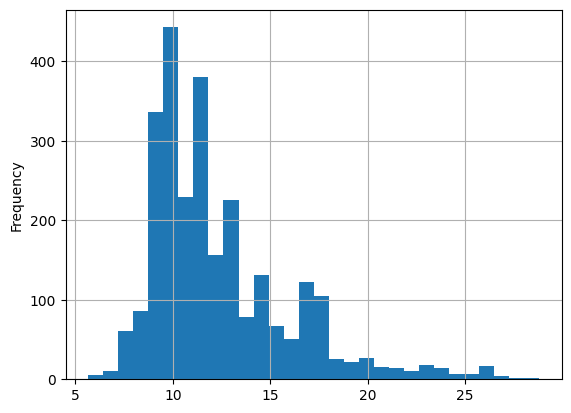

In [9]:
#wind gust assign nan when no gust. units m/s
df["wind_gust_o"]=pd.to_numeric(df["gust"], downcast="float",errors='coerce')*0.514444

df.loc[df.wind_gust_o<0,"wind_gust_o"]="M"
#mask = (df.time > '2011-08-01') & (df.time <= '2011-11-05') & (df.wind_gust_o<0)
#df.loc[mask,["wind_gust_o","metar_o","time"]].set_index("time")
df["wind_gust_o"]=df["wind_gust_o"].fillna("M")
print(df["wind_gust_o"].describe())

pd.to_numeric(df["wind_gust_o"],downcast="float",errors="coerce").plot(kind="hist",bins=30,grid=True);

df.wind_gust_o.sample(30)

In [10]:
import plotly.express as px
fig = px.line(df,x="time",y="wind_gust_o", title="wind_gust_o figure")
fig.show()


In [ ]:
#One hour precipitation for the period from the observation time to the time of the previous hourly precipitation reset.
#This value may or may not contain frozen precipitation melted by some device on the sensor or estimated by some other means
#transformed from inches to mm
df["prec_o"]=pd.to_numeric(df["p01i"], downcast="float",errors='coerce')*25.4
print(df["prec_o"].describe())

import plotly.express as px
fig = px.line(df,x="time",y="prec_o", title="Var figure")
fig.show()

In [11]:
#QNH in hpa
df["mslp_o"]=round(pd.to_numeric(df["alti"], downcast="float",errors='coerce')*33.8638,0)
df.loc[df.mslp_o<900,"mslp_o"]=np.nan
df.loc[df.mslp_o>1100,"mslp_o"]=np.nan
print(df["mslp_o"].describe())
print(df.loc[df["time"]=="2013-01-19 06:30:00",["mslp_o","metar"]])
print(df[["mslp_o","metar"]])

import plotly.express as px
fig = px.line(df,x="time",y="mslp_o", title="mslp_o figure")
fig.show()

count    87996.000000
mean      1016.443481
std          6.872558
min        988.000000
25%       1013.000000
50%       1016.000000
75%       1021.000000
max       1037.000000
Name: mslp_o, dtype: float64
Empty DataFrame
Columns: [mslp_o, metar]
Index: []
       mslp_o                                              metar
0      1018.0  LEBL 010000Z 28014KT 9999 FEW020 14/04 Q1018 N...
1      1018.0  LEBL 010030Z 28012KT 9999 FEW020 14/02 Q1018 N...
2      1019.0  LEBL 010100Z 31013KT 9999 FEW020 13/00 Q1019 N...
3      1019.0  LEBL 010130Z 32013G25KT 290V350 9999 FEW020 12...
4      1020.0  LEBL 010200Z 32013KT 9999 FEW020 11/01 Q1020 N...
...       ...                                                ...
87995  1023.0       LEBL 302130Z 29008KT CAVOK 14/09 Q1023 NOSIG
87996  1023.0  LEBL 302200Z 27006KT 9999 FEW050 13/09 Q1023 N...
87997  1024.0       LEBL 302230Z 28006KT CAVOK 12/09 Q1024 NOSIG
87998  1024.0       LEBL 302300Z 29009KT CAVOK 12/09 Q1024 NOSIG
87999  1024.0       LEBL 3023

In [ ]:
#Sea Level Pressure in hPa . Unknown. Data are incompletely
pd.to_numeric(df["mslp"], downcast="float",errors='coerce').describe()


count    30121.000000
mean      1017.220886
std          7.230199
min        974.299988
25%       1014.200012
50%       1018.000000
75%       1021.299988
max       1037.699951
Name: mslp, dtype: float64

       visibility_o                                              metar
35025        9994.0       LEBL 241800Z 32009KT CAVOK 13/08 Q1025 NOSIG
47017        9994.0  LEBL 291930Z 36004KT 9999 FEW020 20/15 Q1005 N...
45732        5005.0  LEBL 030000Z 19010KT 5000 SHRA FEW018CB BKN025...
70500         145.0  LEBL 010800Z 29005KT 250V330 0150 R25R/1700D R...
9614         9994.0  LEBL 172230Z 11003KT 9999 FEW015 25/23 Q1017 N...
30702        9994.0  LEBL 261200Z 18006KT 120V230 9999 FEW015 25/17...
15530        9994.0  LEBL 160630Z 33007KT 9999 FEW018 13/12 Q1020 N...
4941         9994.0  LEBL 121100Z 22012KT 9999 FEW030 14/08 Q1001 N...
16547        9994.0  LEBL 070830Z 33012G24KT 260V360 CAVOK 09/06 Q1...
77395        9994.0  LEBL 242000Z 05012KT 9999 FEW008 SCT014 16/15 ...
54231        9994.0  LEBL 262030Z 27008KT 9999 FEW015 11/10 Q1022 N...
66068        9994.0  LEBL 301900Z 24007KT 9999 FEW022 21/17 Q1022 N...
35417        9994.0  LEBL 012300Z 32008KT 9999 FEW023 07/04 Q1032 N...
70936 

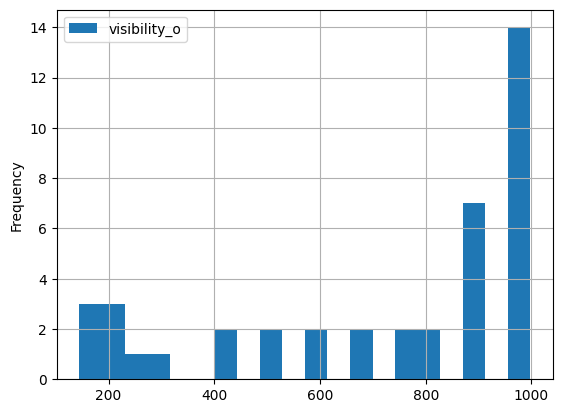

In [12]:
#visibility in meters
df["visibility_o"]=round(pd.to_numeric(df["vsby"], downcast="float",errors='coerce')*1609.344,0)
df.loc[df.visibility_o<=0,"visibility_o"]=np.nan
df.loc[df.visibility_o>9999,"visibility_o"]=9999
print(df[["visibility_o","metar"]].sample(20))
print(df["visibility_o"].describe())
df.loc[df.visibility_o<=1000,["visibility_o"]].plot(kind="hist",grid=True,bins=20);
import plotly.express as px
fig = px.line(df,x="time",y="visibility_o", title="Var figure")
fig.show()


In [13]:
#pd.to_numeric(df["skyl1"], downcast="float",errors='ignore').sample(100)
#df[["skyc1","skyl1","skyc2","skyl2","skyc3","skyl3","skyc4","skyl4","metar"]].sample(30)
df["skyc1_o"]=df["skyc1"]
df["skyc2_o"]=df["skyc2"]
df["skyc3_o"]=df["skyc3"]
df["skyl1_o"]=round(pd.to_numeric(df["skyl1"], downcast="float",errors='coerce')*0.3048,0)
df["skyl1_o"]=df.skyl1_o.fillna(-1)
df.loc[df.skyl1_o>2000,"skyl1_o"]=np.nan
df["skyl1_o"]=df["skyl1_o"].replace(-1,"M")
print(df[["skyl1_o","metar"]].describe())
print(df[["skyl1_o","metar"]].sample(30))
df["skyl2_o"]=round(pd.to_numeric(df["skyl2"], downcast="float",errors='coerce')*0.3048,0)
df["skyl2_o"]=df.skyl2_o.fillna("M")
print(df[["skyl2_o","metar"]].describe())
df["skyl3_o"]=round(pd.to_numeric(df["skyl3"], downcast="float",errors='coerce')*0.3048,0)
df["skyl3_o"]=df.skyl3_o.fillna("M")
print(df[["skyl3_o","metar"]].describe())
df["skyl4_o"]=round(pd.to_numeric(df["skyl4"], downcast="float",errors='coerce')*0.3048,0)
df["skyl4_o"]=df.skyl4_o.fillna("M")
print(df[["skyl4_o","metar"]].describe())

import plotly.express as px
fig = px.line(df,x="time",y="skyl4_o", title="Var figure")
fig.show()

       skyl1_o                                              metar
count    87997                                              88000
unique      63                                              87997
top          M  LEBL 152318Z 34004KT 9999 -DZ FEW018 21/19 Q10...
freq     26331                                                  2
      skyl1_o                                              metar
41822   914.0  LEBL 132230Z VRB01KT 9999 FEW030 18/14 Q1006 N...
53785       M  LEBL 171330Z 19005KT 160V220 CAVOK 14/02 Q1020...
68330   914.0  LEBL 171400Z 19007KT 9999 FEW030 15/09 Q1019 N...
18247       M      LEBL 112330Z 34007KT CAVOK 03/M04 Q1026 NOSIG
46648   457.0  LEBL 220130Z 03002KT 9999 FEW015 SCT027 26/23 ...
3578   1219.0  LEBL 150900Z 25009KT 9999 FEW040 14/08 Q0999 N...
21728       M  LEBL 251000Z 32004KT 250V020 CAVOK 19/04 Q1020...
47212  1219.0  LEBL 022200Z 01002KT 9999 FEW040 23/16 Q1019 N...
63402   671.0  LEBL 061100Z 09012KT 060V120 9999 SCT022 BKN05...
59134   366.0  LEBL 

In [15]:
#wxcodes
pd.options.display.max_rows=100
display(df.wxcodes.value_counts(normalize=True).map(lambda n: '{:.2%}'.format(n)))
df["wxcodes_o"]=df["wxcodes"]

M                 94.43%
-RA                1.96%
-DZ                0.72%
RA                 0.63%
BR                 0.53%
SHRA               0.18%
VCTS               0.14%
-SHRA              0.13%
TSRA               0.12%
VCSH               0.09%
TS                 0.08%
DZ                 0.07%
+RA                0.07%
+TSRA              0.07%
-TSRA              0.06%
-RA BR             0.05%
-RA VCTS           0.05%
BCFG               0.05%
+SHRA              0.04%
BR -RA             0.04%
BR BCFG            0.04%
-RA VCSH           0.03%
FG                 0.03%
VCFG               0.02%
BR -DZ             0.02%
TS -RA             0.02%
VCTS -RA           0.02%
-SHRA VCTS         0.02%
RA VCTS            0.02%
SHRA VCTS          0.01%
+SHRA VCTS         0.01%
-DZ BR             0.01%
RA BR              0.01%
BR RA              0.01%
-RA TS             0.01%
BR DZ              0.01%
TS VCSH            0.01%
BR VCFG            0.01%
VCSH -RA           0.01%
BCFG BR            0.01%


In [16]:
#metar
df["metar_o"]=df["metar"]

In [17]:
#last review
print(df[['time','temp_o','tempd_o', 'rh_o', 'dir_o', 'spd_o', 'wind_gust_o','mslp_o',
       'visibility_o', 'skyc1_o', 'skyc2_o', 'skyc3_o', 'skyl1_o', 'skyl2_o',
       'skyl3_o', 'wxcodes_o', 'metar_o']].info())
df[['time','temp_o','tempd_o', 'rh_o', 'dir_o', 'spd_o', 'wind_gust_o','mslp_o',
       'visibility_o', 'skyc1_o', 'skyc2_o', 'skyc3_o', 'skyl1_o', 'skyl2_o',
       'skyl3_o', 'wxcodes_o', 'metar_o']].describe()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 88000 entries, 0 to 87999
Data columns (total 17 columns):
 #   Column        Non-Null Count  Dtype         
---  ------        --------------  -----         
 0   time          88000 non-null  datetime64[ns]
 1   temp_o        87994 non-null  float32       
 2   tempd_o       87994 non-null  float32       
 3   rh_o          87911 non-null  float32       
 4   dir_o         88000 non-null  float32       
 5   spd_o         87998 non-null  float32       
 6   wind_gust_o   88000 non-null  object        
 7   mslp_o        87996 non-null  float32       
 8   visibility_o  87997 non-null  float32       
 9   skyc1_o       88000 non-null  object        
 10  skyc2_o       88000 non-null  object        
 11  skyc3_o       88000 non-null  object        
 12  skyl1_o       87997 non-null  object        
 13  skyl2_o       88000 non-null  object        
 14  skyl3_o       88000 non-null  object        
 15  wxcodes_o     87998 non-null  object

,temp_o,tempd_o,rh_o,dir_o,spd_o,mslp_o,visibility_o
count,87994.000000,87994.000000,87911.000000,88000.000000,87998.000000,87996.000000,87997.000000
mean,290.223816,284.883148,72.160980,219.636688,4.012994,1016.443481,9794.984375
std,6.485481,6.471854,13.423498,109.678787,2.217915,6.872558,914.742493
min,273.149994,258.149994,10.270000,-1.000000,0.000000,988.000000,145.000000
25%,285.149994,280.149994,63.599998,120.000000,2.572220,1013.000000,9994.000000
50%,290.149994,285.149994,73.440002,230.000000,3.601108,1016.000000,9994.000000
75%,296.149994,290.149994,82.120003,320.000000,5.144440,1021.000000,9994.000000
max,309.149994,299.149994,100.000000,360.000000,20.577759,1037.000000,9994.000000


In [18]:
df=df.drop_duplicates(subset="time")

In [ ]:
#save results
from google.colab import drive
drive.mount('/content/drive')
df[['time','temp_o','tempd_o', 'rh_o', 'dir_o', 'spd_o', 'wind_gust_o','mslp_o',
       'visibility_o', 'skyc1_o', 'skyc2_o', 'skyc3_o', 'skyl1_o', 'skyl2_o',
       'skyl3_o', 'wxcodes_o', 'metar_o']].to_csv("/content/drive/My Drive/Colab Notebooks/ML_database/met_stations/"+station+".csv")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [20]:
df_final = df[['time','temp_o','tempd_o', 'rh_o', 'dir_o', 'spd_o', 'wind_gust_o','mslp_o',
       'visibility_o', 'skyc1_o', 'skyl1_o', 'wxcodes_o', 'metar_o']]

In [21]:
df_final.describe()

,temp_o,tempd_o,rh_o,dir_o,spd_o,mslp_o,visibility_o
count,87994.000000,87994.000000,87911.000000,88000.000000,87998.000000,87996.000000,87997.000000
mean,290.223816,284.883148,72.160980,219.636688,4.012994,1016.443481,9794.984375
std,6.485481,6.471854,13.423498,109.678787,2.217915,6.872558,914.742493
min,273.149994,258.149994,10.270000,-1.000000,0.000000,988.000000,145.000000
25%,285.149994,280.149994,63.599998,120.000000,2.572220,1013.000000,9994.000000
50%,290.149994,285.149994,73.440002,230.000000,3.601108,1016.000000,9994.000000
75%,296.149994,290.149994,82.120003,320.000000,5.144440,1021.000000,9994.000000
max,309.149994,299.149994,100.000000,360.000000,20.577759,1037.000000,9994.000000


In [22]:
df_final.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 88000 entries, 0 to 87999
Data columns (total 13 columns):
 #   Column        Non-Null Count  Dtype         
---  ------        --------------  -----         
 0   time          88000 non-null  datetime64[ns]
 1   temp_o        87994 non-null  float32       
 2   tempd_o       87994 non-null  float32       
 3   rh_o          87911 non-null  float32       
 4   dir_o         88000 non-null  float32       
 5   spd_o         87998 non-null  float32       
 6   wind_gust_o   88000 non-null  object        
 7   mslp_o        87996 non-null  float32       
 8   visibility_o  87997 non-null  float32       
 9   skyc1_o       88000 non-null  object        
 10  skyl1_o       87997 non-null  object        
 11  wxcodes_o     87998 non-null  object        
 12  metar_o       88000 non-null  object        
dtypes: datetime64[ns](1), float32(7), object(5)
memory usage: 7.0+ MB


In [23]:
df_final.to_csv("LEBLY20180101Y20221231.csv",index = False)

In [ ]:
data=collections.Counter(df["wxcodes"])
data_sorted = {k: v for k, v in sorted(data.items(), key=lambda x: x[1])}
print(data_sorted)

NameError: ignored